In [1]:
#import 
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

2 Single-Scale Lucas-Kanade Optical Flow

2.1 Keypoint Selection: Selecting Pixels to Track

Use OpenCV’s Harris Corner Detector implementation and visualize the feature points obtained
by the algorithm. Visualize the detected pixels superimposed on the images for at least one
image from each of the given sequences. This part of the assignment is based on the 1988
work,A Combined Corner and Edge Detector, by ChrisHarris and Mike Stephens.
Reference image


In [2]:
def HarrisCornerDetector(image,filename):
    img = cv.imread(image)
    gray = cv.cvtColor(img,cv.COLOR_BGR2GRAY)
    gray = np.float32(gray)
    dst = cv.cornerHarris(gray,2,3,0.04)
    #result is dilated for marking the corners, not important
    dst = cv.dilate(dst,None)
    # print(dst)
    img_coord = []
    # Threshold for an optimal value, it may vary depending on the image.
    img[dst>0.01*dst.max()]=[0,0,255]
    plt.figure("Harris detector")
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.xticks([]), plt.yticks([])
    # plt.savefig(filename, bbox_inches='tight')
    plt.show()
    # cv.imshow('dst',img)
    for i in range(len(img)):
        for j in range(len(img[i])):
            if img[i][j][2] == 255 and img[i][j][1] == 0 and img[i][j][0] == 0:
                img_coord.append([i,j])
    # print(len(img_coord))
    return img_coord

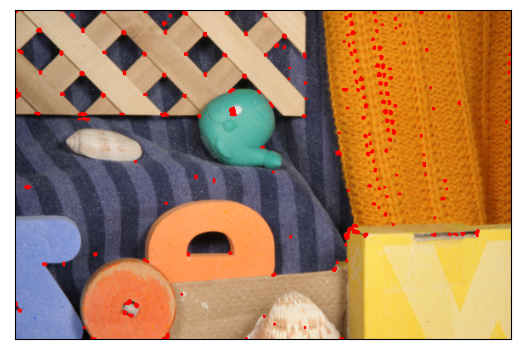

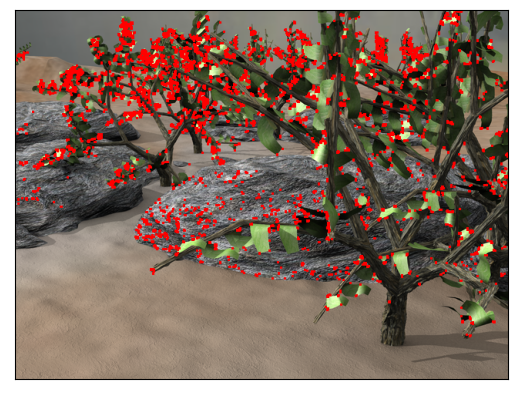

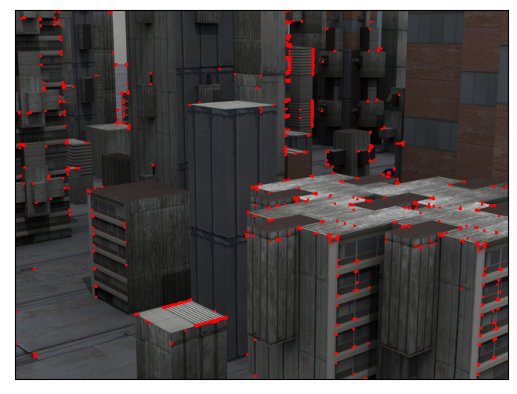

In [3]:
img_r=HarrisCornerDetector("../data/all-frames-colour/RubberWhale/frame07.png","RubberWhale.png")
img_g=HarrisCornerDetector("../data/all-frames-colour/Grove3/frame07.png","Grove3.png")
img_u= HarrisCornerDetector("../data/all-frames-colour/Urban2/frame07.png","Urban2.png")

In [4]:
corn_points=[]
corn_points.append(img_g)
corn_points.append(img_r)
corn_points.append(img_u)

2.2 Forward-Additive Sparse Optical Flow

The main task is to implement the single-scale Lucas-Kanade (LK) algorithm.

The main task can be broken into the following sub-parts:
1. Visualizing the dense optical flow of the .flo filesgiven (Use the helper code of this)
2. Implement sparse LK Method
3. Plotting and comparing your implementation and OpenCV implementation for all
consecutive frames for the three sequences. You have to add quiver plots superimpose
on the images. (OpenCV implementation uses multi-scale LK so It is alright if the results
are not the same, but the general flow will still be the same)
4. Create a video out of the images to show the optical flow (This is an optional task, it
helps you to see if the optical flow vectors are in line with the actual motion of the
images)
5. Compute the Average End Point Error (EPE) between the ground truth optical flow in
.flo files and your predicted optical flow (only forthe feature points detec


In [5]:
# Source:https://github.com/sampepose/flownet2-tf/blob/master/src/flowlib.py
import matplotlib.pyplot as plt
import numpy as np

UNKNOWN_FLOW_THRESH = 1e7
def show_flow(filename):
    """
    visualize optical flow map using matplotlib
    :param filename: optical flow file
    :return: None
    """
    flow = read_flow(filename)
    img = flow_to_image(flow)
    plt.imshow(img)
    plt.show()

def read_flow(filename):
    """
    read optical flow from Middlebury .flo file
    :param filename: name of the flow file
    :return: optical flow data in matrix
    """
    f = open(filename, 'rb')
    magic = np.fromfile(f, np.float32, count=1)
    data2d = None

    if 202021.25 != magic:
        print ('Magic number incorrect. Invalid .flo file')
    else:
        w = int(np.fromfile(f, np.int32, count=1)[0])
        h = int(np.fromfile(f, np.int32, count=1)[0])
        #print("Reading %d x %d flo file" % (h, w))
        data2d = np.fromfile(f, np.float32, count=2 * w * h)
        # reshape data into 3D array (columns, rows, channels)
        data2d = np.resize(data2d, (h, w, 2))
    f.close()
    return data2d

def flow_to_image(flow):
    """
    Convert flow into middlebury color code image
    :param flow: optical flow map
    :return: optical flow image in middlebury color
    """
    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999.
    maxv = -999.
    minu = 999.
    minv = 999.

    idxUnknow = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknow] = 0
    v[idxUnknow] = 0

    maxu = max(maxu, np.max(u))
    minu = min(minu, np.min(u))

    maxv = max(maxv, np.max(v))
    minv = min(minv, np.min(v))

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(-1, np.max(rad))

    u = u/(maxrad + np.finfo(float).eps)
    v = v/(maxrad + np.finfo(float).eps)

    img = compute_color(u, v)

    idx = np.repeat(idxUnknow[:, :, np.newaxis], 3, axis=2)
    img[idx] = 0

    return np.uint8(img)


def compute_color(u, v):
    """
    compute optical flow color map
    :param u: optical flow horizontal map
    :param v: optical flow vertical map
    :return: optical flow in color code
    """
    [h, w] = u.shape
    img = np.zeros([h, w, 3])
    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = make_color_wheel()
    ncols = np.size(colorwheel, 0)

    rad = np.sqrt(u**2+v**2)

    a = np.arctan2(-v, -u) / np.pi

    fk = (a+1) / 2 * (ncols - 1) + 1

    k0 = np.floor(fk).astype(int)

    k1 = k0 + 1
    k1[k1 == ncols+1] = 1
    f = fk - k0

    for i in range(0, np.size(colorwheel,1)):
        tmp = colorwheel[:, i]
        col0 = tmp[k0-1] / 255
        col1 = tmp[k1-1] / 255
        col = (1-f) * col0 + f * col1

        idx = rad <= 1
        col[idx] = 1-rad[idx]*(1-col[idx])
        notidx = np.logical_not(idx)

        col[notidx] *= 0.75
        img[:, :, i] = np.uint8(np.floor(255 * col*(1-nanIdx)))

    return img


def make_color_wheel():
    """
    Generate color wheel according Middlebury color code
    :return: Color wheel
    """
    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros([ncols, 3])

    col = 0

    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.transpose(np.floor(255*np.arange(0, RY) / RY))
    col += RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.transpose(np.floor(255*np.arange(0, YG) / YG))
    colorwheel[col:col+YG, 1] = 255
    col += YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.transpose(np.floor(255*np.arange(0, GC) / GC))
    col += GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.transpose(np.floor(255*np.arange(0, CB) / CB))
    colorwheel[col:col+CB, 2] = 255
    col += CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.transpose(np.floor(255*np.arange(0, BM) / BM))
    col += + BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.transpose(np.floor(255 * np.arange(0, MR) / MR))
    colorwheel[col:col+MR, 0] = 255

    return colorwheel

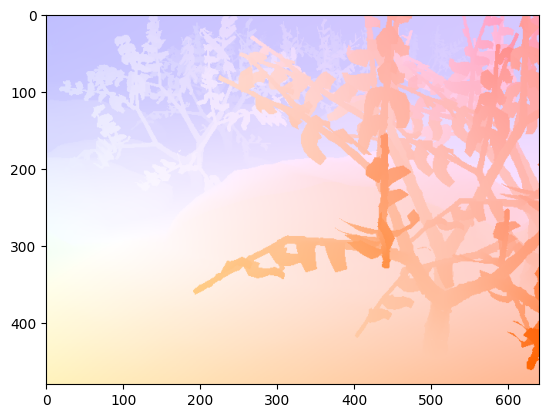

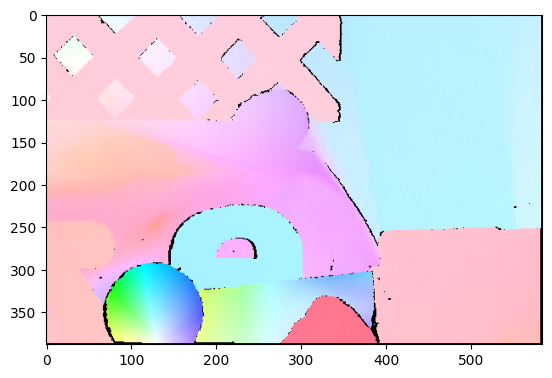

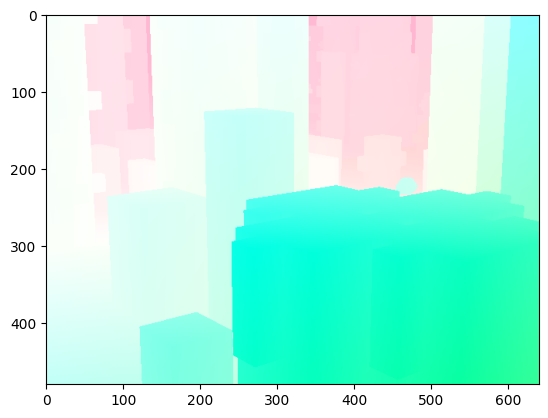

In [6]:
show_flow("../data/ground-truth-flow/Grove3/flow10.flo")
show_flow("../data/ground-truth-flow/RubberWhale/flow10.flo")
show_flow("../data/ground-truth-flow/Urban2/flow10.flo")

In [7]:
def space(u,v,dist):
    new_u=[]
    new_v=[]
    for i in range(len(u)):
        for j in range(len(u[0])):
            if (u[i][j]!=0):
                flag=0
                for k in range(len(new_u)):
                    if(abs(i-new_u[k])<dist and abs(j-new_v[k])<dist):
                        flag=1
                        break
                if(flag==0):
                    new_u.append(i)
                    new_v.append(j)
    return new_u,new_v

In [8]:
def quiver_plot(img, u, v, threshold,img_coord,dist_thresh):
    # Threshold the magnitude of the optical flow vectors
    dict_coord={}
    for i in range(len(img_coord)):
        dict_coord[str(img_coord[i][0])+"+"+str(img_coord[i][1])]=1
    img=cv.imread(img)
    x=u
    y=v
    magnitude = np.sqrt(u**2 + v**2)
    x[magnitude < abs(threshold)] = 0
    y[magnitude < abs(threshold)] = 0
    plt.imshow(img)
    new_u,new_v=space(x,y,dist_thresh)
    cnt=0
    for i in range(len(new_u)):
            x_c=new_u[i]
            y_c=new_v[i]
            if(( str(x_c)+"+"+str(y_c)) in dict_coord.keys()):
                cnt+=1
                plt.quiver(y_c,x_c,u[x_c][y_c],v[x_c][y_c], color = "red")
    plt.show()
    plt.clf()

In [9]:
def LucasKanadeForwardAdditive(Img1, Img2, windowSize, tau=0.01):
    img1 = Img1 / 255.0 # normalize pixels
    img2 = Img2 / 255.0
    height, width = img1.shape
    windowh=(int)(windowSize[0]/2)
    windoww=(int)(windowSize[1]/2)
    u = np.zeros((height, width), np.float32)
    v = np.zeros((height, width), np.float32)

    #  gradient of the images
    Ix = cv.Sobel(img1, cv.CV_64F, 1, 0, ksize=5)
    Iy = cv.Sobel(img1, cv.CV_64F, 0, 1, ksize=5)
    It = img2 - img1

    # traverse over the image
    for y in range(windowh, height-windowh):
        for x in range(windoww, width-windoww):
            #  window
            windowIx = Ix[y-windowh:y+windowh+1, x-windoww:x+windoww+1].flatten()
            windowIy = Iy[y-windowh:y+windowh+1, x-windoww:x+windoww+1].flatten()
            windowIt = It[y-windowh:y+windowh+1, x-windowh:x+windowh+1].flatten()
            b = -windowIt
            A = np.vstack((windowIx, windowIy)).T
            if np.min(abs(np.linalg.eigvals(np.matmul(A.T, A)))) >= tau:
                o_f = np.dot(np.linalg.pinv(A), b)
                u[y][x]=o_f[0]
                v[y][x]=o_f[1]
    return u,v

In [23]:
def avg_epe(u_flow,v_flow,path,img_coord):
    dict_coord={}
    for i in range(len(img_coord)):
        dict_coord[str(img_coord[i][0])+"+"+str(img_coord[i][1])]=1
    orig_flow = read_flow(path)
    u_val = orig_flow[:,:,0]
    v_val = orig_flow[:,:,1]
    cnt=0
    error=0.0
    for i in range(len(u_flow)):
        for j in range(len(u_flow[0])):
            if((str(i)+"+"+str(j)) in dict_coord.keys()):
                error+=((u_flow[i][j]-u_val[i][j])**2+(v_flow[i][j]-v_val[i][j])**2)**0.5
                cnt+=1
    return error/(cnt)

In [11]:
def opencvLK_with_harriscorner(Img1,Img2):
    img1 = cv.imread(Img1)
    img2 = cv.imread(Img2)
    gray1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
    gray2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)
    corners1 = cv.goodFeaturesToTrack(gray1, maxCorners=100, qualityLevel=0.01, minDistance=10)
    corners1 =corners1.astype(np.float32)
    pt=[]
    for i in range(len(corners1)):
        pt.append([corners1[i][0][0],corners1[i][0][1]])
    flow, status, error = cv.calcOpticalFlowPyrLK(gray1, gray2, corners1, None,flags=cv.OPTFLOW_LK_GET_MIN_EIGENVALS , winSize=(15, 15), maxLevel=0, criteria=(cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03))

    # corresponding points in the second image
    corners2 = flow
    U = corners2[:, 0, 0] - corners1[:, 0, 0]
    V = corners2[:, 0, 1] - corners1[:, 0, 1]
    plt.imshow(img1)
    for i in range(len(pt)):
        plt.quiver(pt[i][0],pt[i][1],U[i],V[i], color = "red")
    plt.show()

In [25]:
def invoke_LucasKanade(): 
    folders = ["Grove3","RubberWhale","Urban2"]
    dist_thresholds = [20,5,5]
    q_thresholds = [0.005,0.00005,0.0005]
    itr = 0
    for i in folders:
        for j in range(7,14):
            nxt=j+1
            print("\n**********Folder: "+folders[itr]+" Frame: "+str(j)+" - "+str(nxt)+"**************\n")
            
            if j < 10:
                Img1="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(j)+".png"
                if(nxt<10):
                    Img2="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(nxt)+".png"
                else:
                    Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
            else:
                Img1="../data/all-frames-colour/"+folders[itr]+"/frame"+str(j)+".png"
                Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
            img1=cv.imread(Img1)
            img2=cv.imread(Img2)
            img1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
            img2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)
            u,v = LucasKanadeForwardAdditive(img1,img2,np.array([15,15]),0.01)
            print("My Implementation\n")
            quiver_plot(Img1,u,v,q_thresholds[itr],corn_points[itr],dist_thresholds[itr])
            print("OpenCV Implementation\n")
            opencvLK_with_harriscorner(Img1,Img2)
            if j==10:
                print("error\n")
                print(avg_epe(u,v,"../data/ground-truth-flow/"+folders[itr]+"/flow10.flo",corn_points[itr]))
        itr = itr + 1


**********Folder: Grove3 Frame: 7 - 8**************

My Implementation



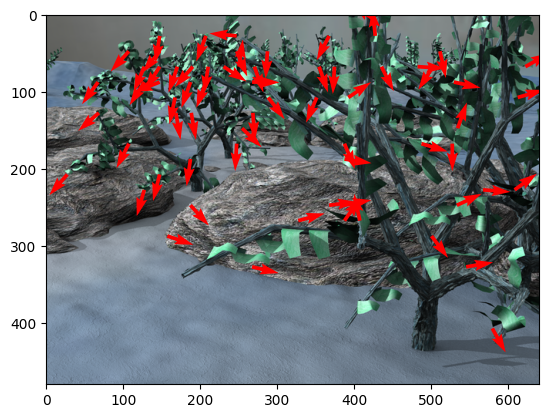

OpenCV Implementation



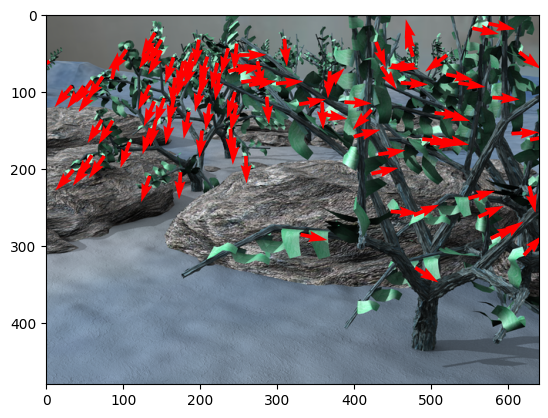


**********Folder: Grove3 Frame: 8 - 9**************

My Implementation



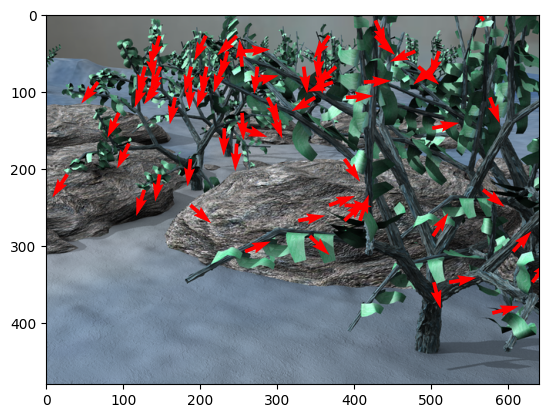

OpenCV Implementation



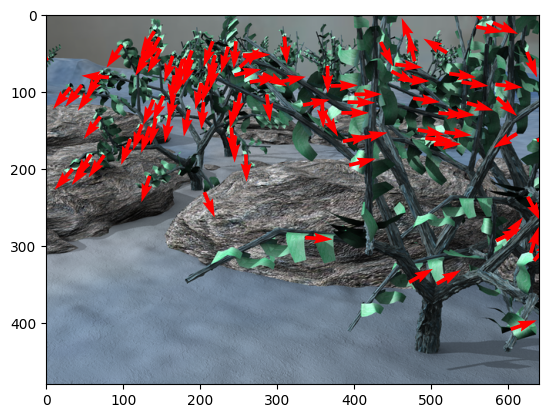


**********Folder: Grove3 Frame: 9 - 10**************

My Implementation



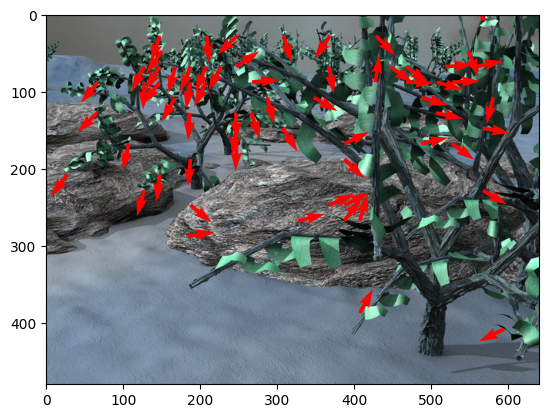

OpenCV Implementation



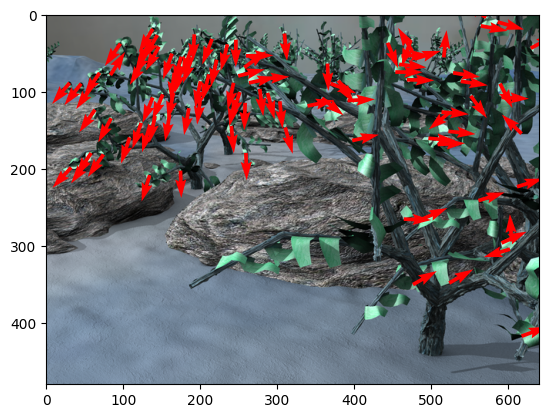


**********Folder: Grove3 Frame: 10 - 11**************

My Implementation



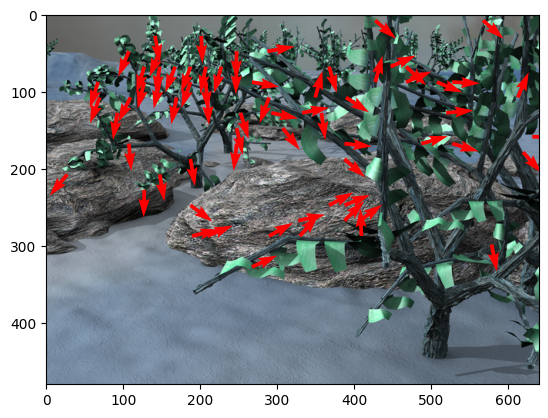

OpenCV Implementation



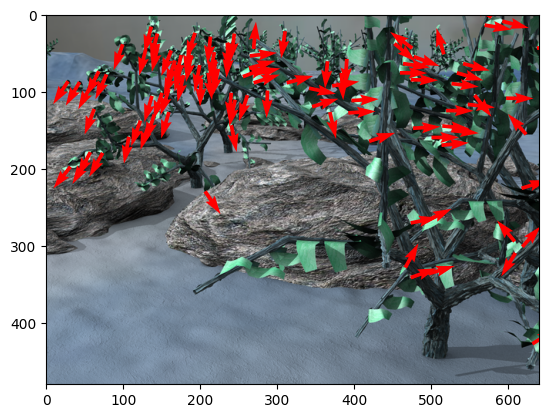

error

3.407206524292716

**********Folder: Grove3 Frame: 11 - 12**************

My Implementation



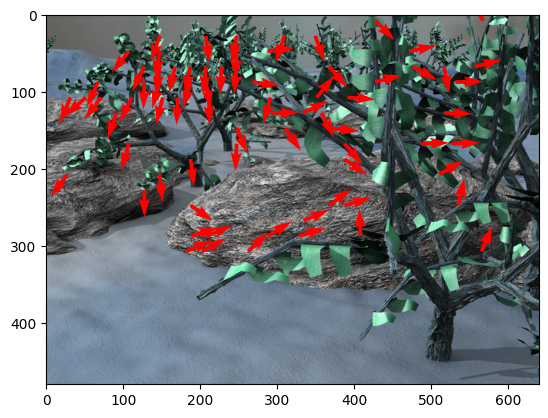

OpenCV Implementation



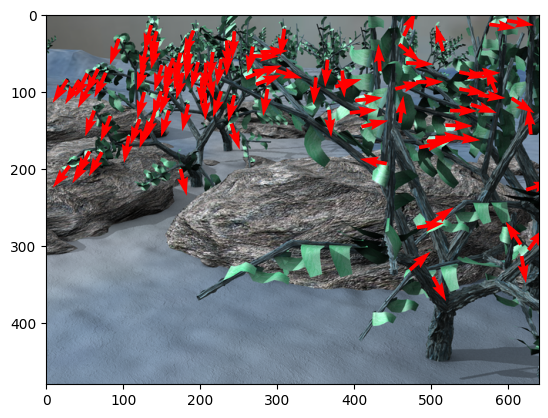


**********Folder: Grove3 Frame: 12 - 13**************

My Implementation



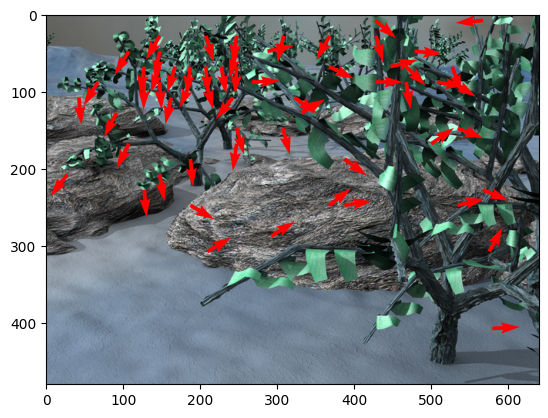

OpenCV Implementation



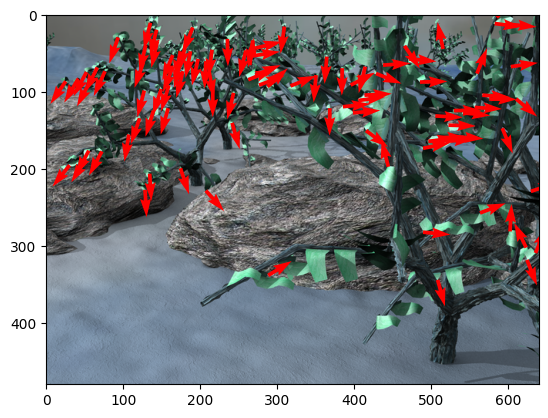


**********Folder: Grove3 Frame: 13 - 14**************

My Implementation



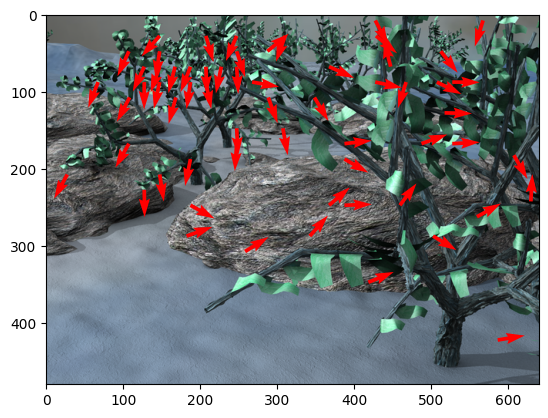

OpenCV Implementation



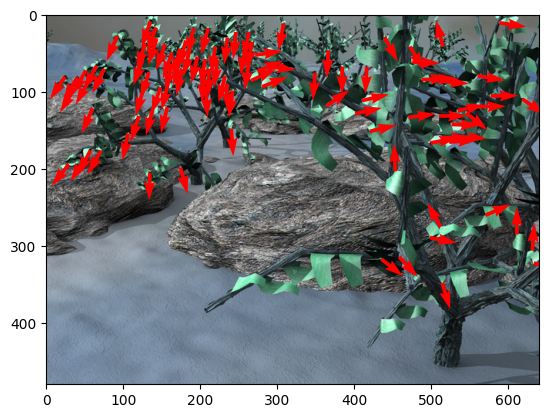


**********Folder: RubberWhale Frame: 7 - 8**************

My Implementation



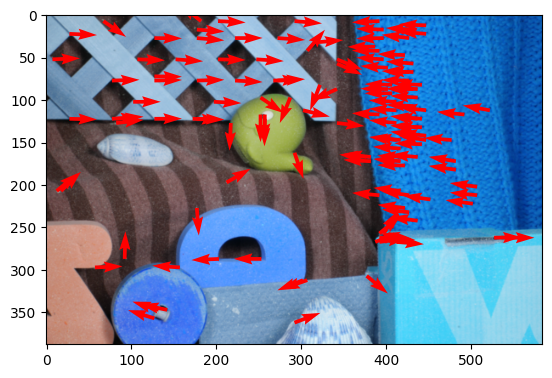

OpenCV Implementation



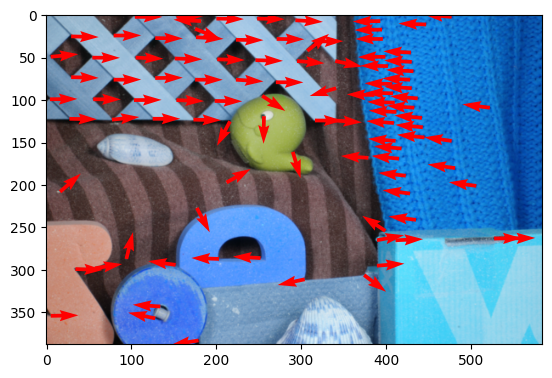


**********Folder: RubberWhale Frame: 8 - 9**************

My Implementation



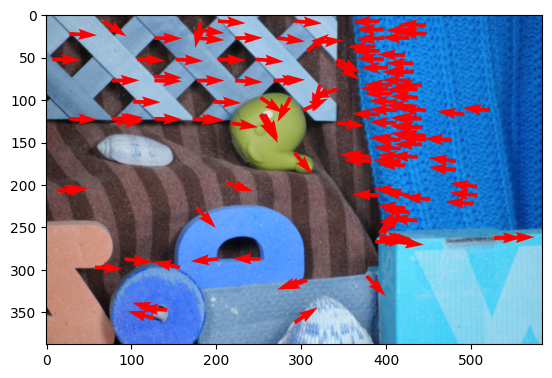

OpenCV Implementation



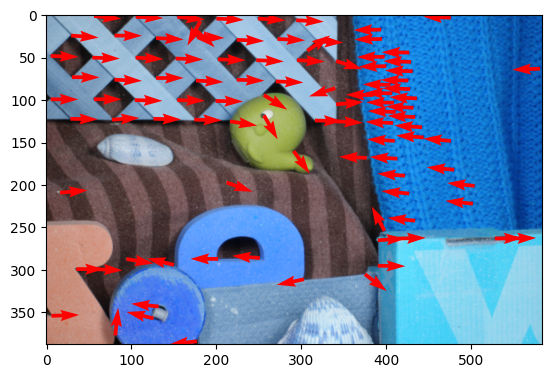


**********Folder: RubberWhale Frame: 9 - 10**************

My Implementation



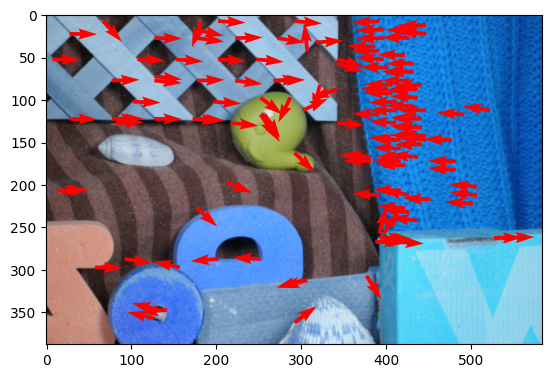

OpenCV Implementation



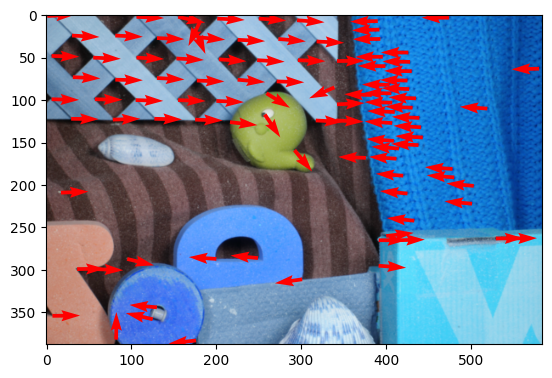


**********Folder: RubberWhale Frame: 10 - 11**************

My Implementation



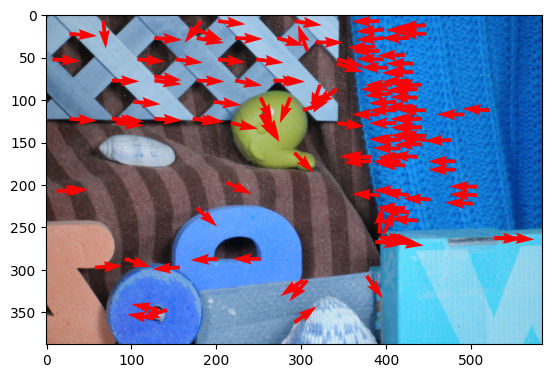

OpenCV Implementation



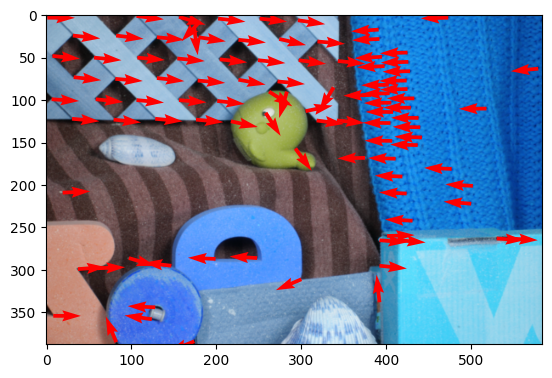

error

91357471.05513935

**********Folder: RubberWhale Frame: 11 - 12**************

My Implementation



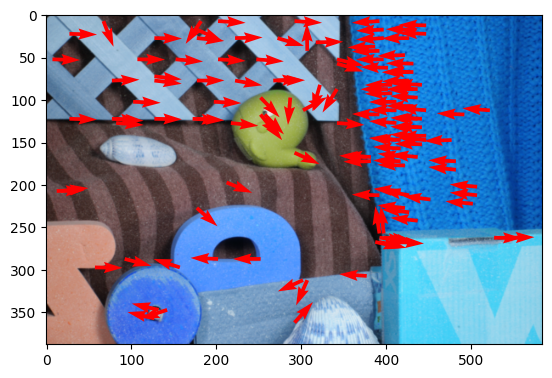

OpenCV Implementation



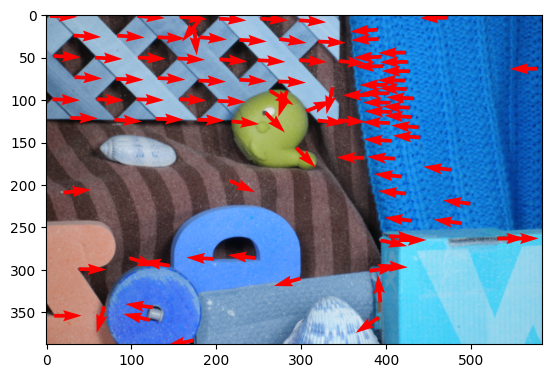


**********Folder: RubberWhale Frame: 12 - 13**************

My Implementation



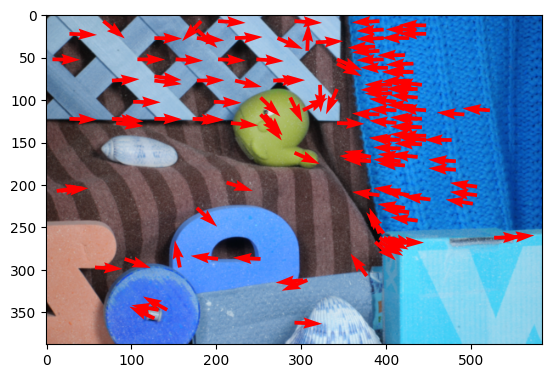

OpenCV Implementation



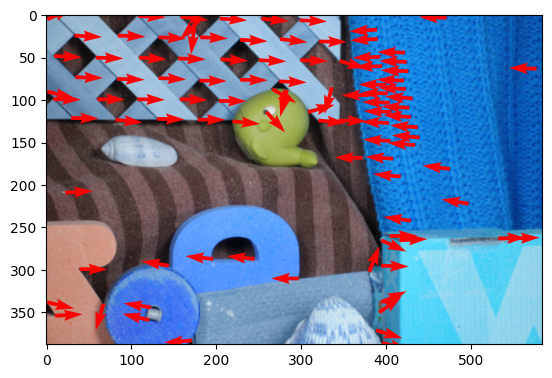


**********Folder: RubberWhale Frame: 13 - 14**************

My Implementation



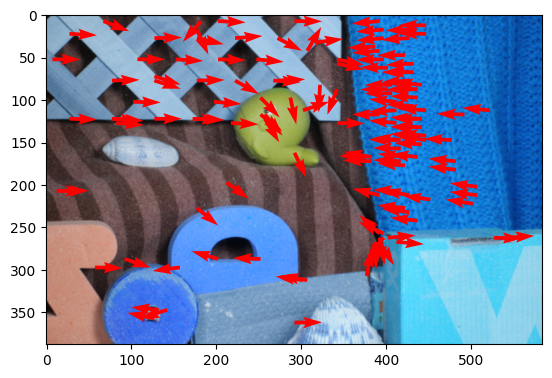

OpenCV Implementation



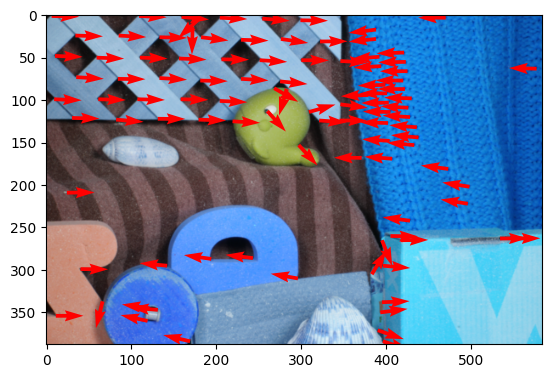


**********Folder: Urban2 Frame: 7 - 8**************

My Implementation



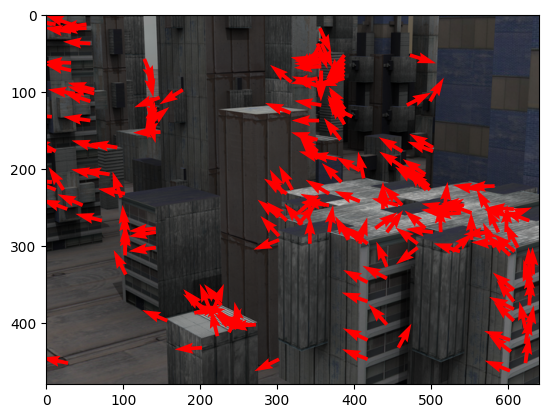

OpenCV Implementation



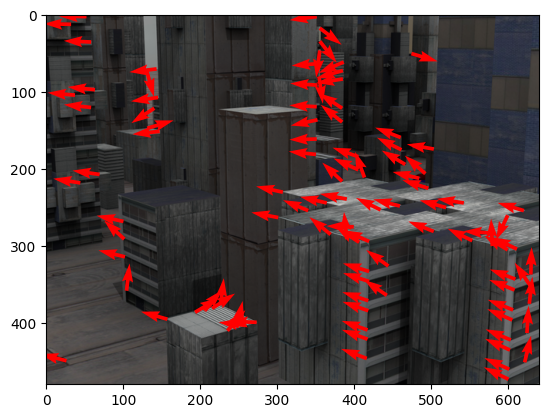


**********Folder: Urban2 Frame: 8 - 9**************

My Implementation



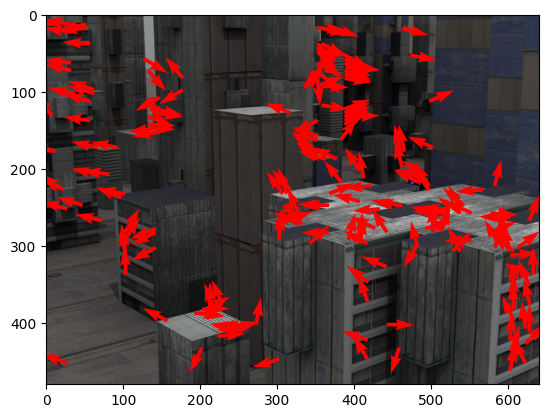

OpenCV Implementation



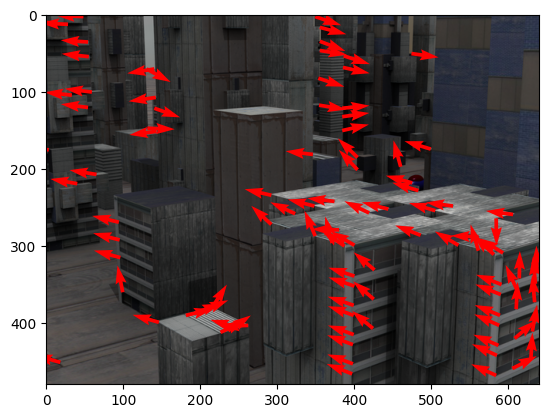


**********Folder: Urban2 Frame: 9 - 10**************

My Implementation



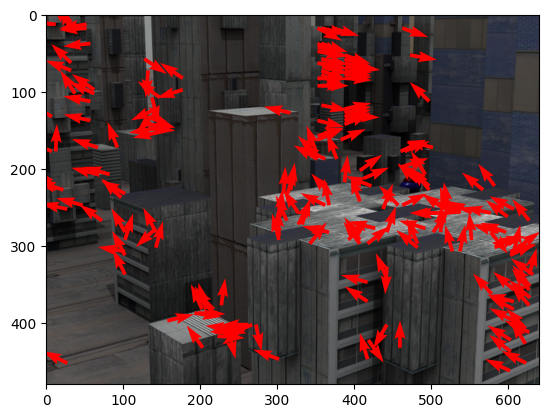

OpenCV Implementation



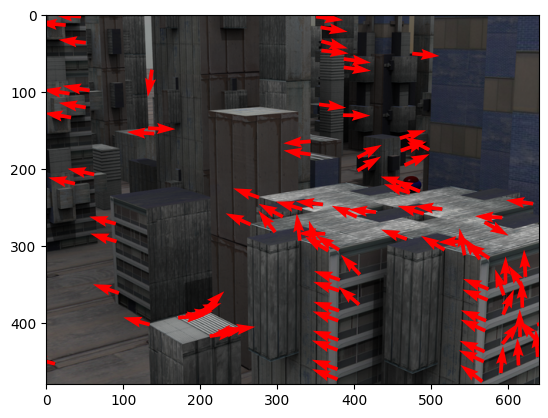


**********Folder: Urban2 Frame: 10 - 11**************

My Implementation



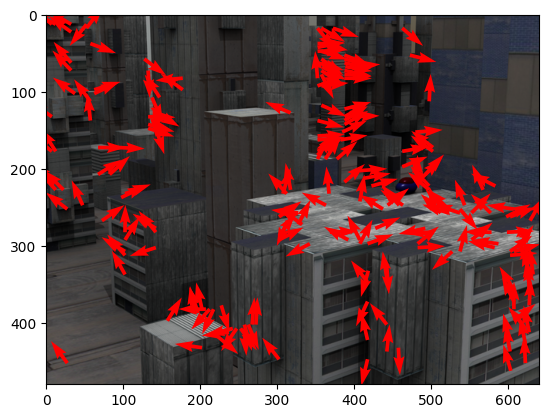

OpenCV Implementation



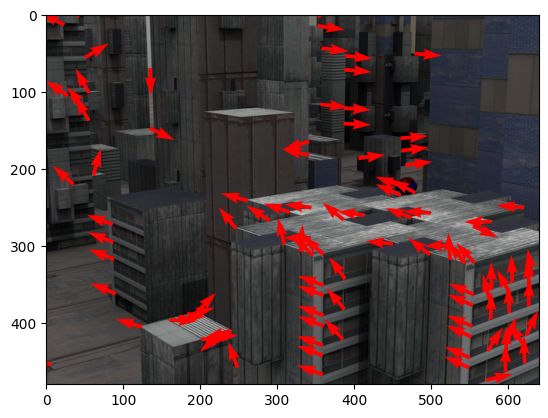

error

9.079247572435973

**********Folder: Urban2 Frame: 11 - 12**************

My Implementation



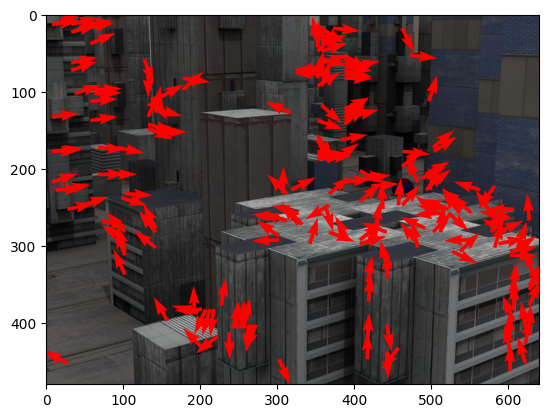

OpenCV Implementation



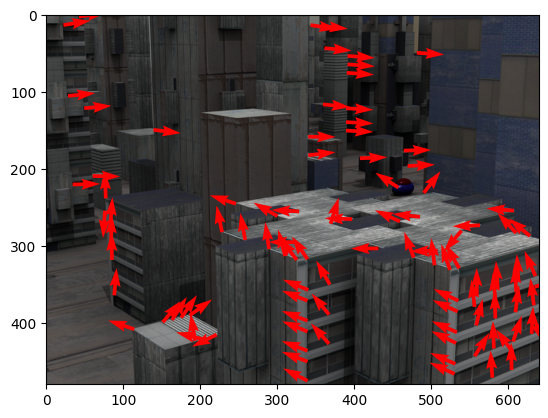


**********Folder: Urban2 Frame: 12 - 13**************

My Implementation



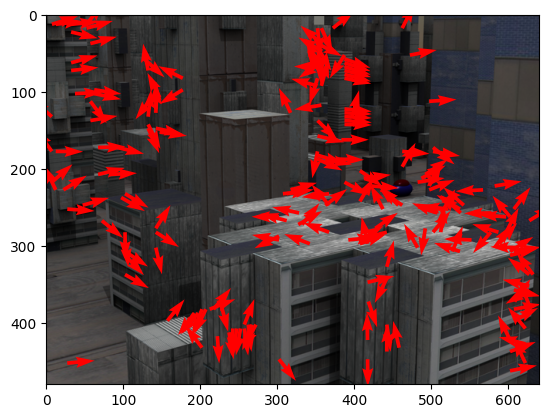

OpenCV Implementation



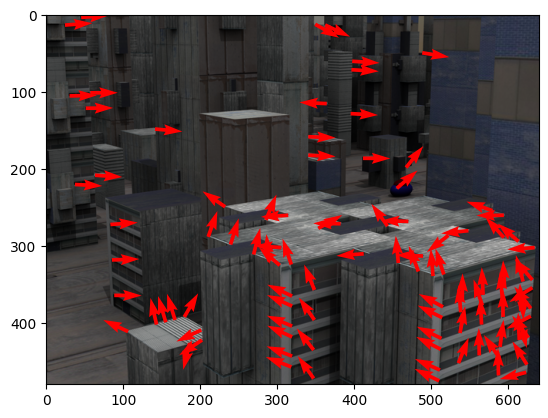


**********Folder: Urban2 Frame: 13 - 14**************

My Implementation



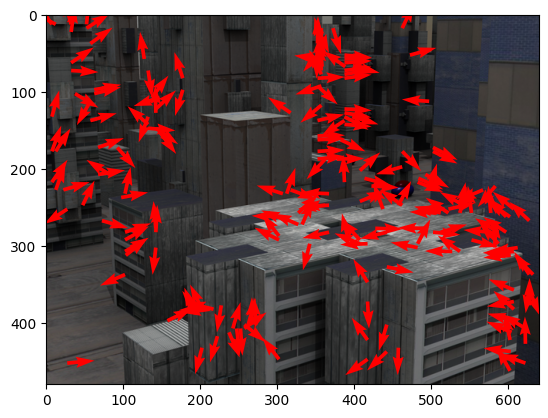

OpenCV Implementation



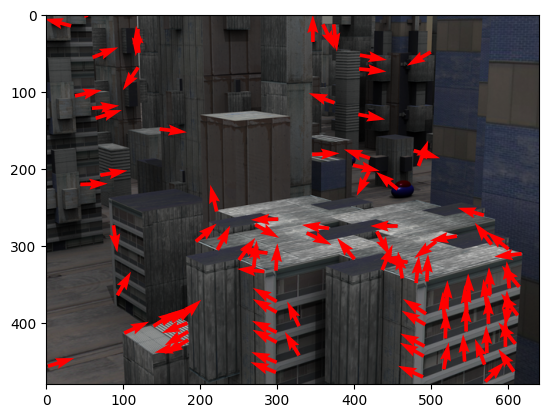

In [26]:
invoke_LucasKanade()

**Effect of changing window size**

In [27]:
def change_window_size(windowlen):
    folders = ["Grove3","RubberWhale","Urban2"]
    dist_thresholds = [20,10,10]
    q_thresholds = [0.005,0.00005,0.0005]
    itr = 0
    for i in folders:
        for j in range(10,11):
            for k in range(2,windowlen,3):
                nxt=j+1
                print("\n**********Folder: "+folders[itr]+" Frame: "+str(j)+" - "+str(nxt)+"**************\n")
                
                if j < 10:
                    Img1="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(j)+".png"
                    if(nxt<10):
                        Img2="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(nxt)+".png"
                    else:
                        Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
                else:
                    Img1="../data/all-frames-colour/"+folders[itr]+"/frame"+str(j)+".png"
                    Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
                img1=cv.imread(Img1)
                img2=cv.imread(Img2)
                img1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
                img2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)
                u,v = LucasKanadeForwardAdditive(img1,img2,np.array([k,k]),0.01)
                print("\nWindow Size: "+str(k)+"\n")
                quiver_plot(Img1,u,v,q_thresholds[itr],corn_points[itr],dist_thresholds[itr])
                if j==10:
                    print("error\n")
                    print(avg_epe(u,v,"../data/ground-truth-flow/"+folders[itr]+"/flow10.flo",corn_points[itr]))
            itr = itr + 1


**********Folder: Grove3 Frame: 10 - 11**************


Window Size: 2



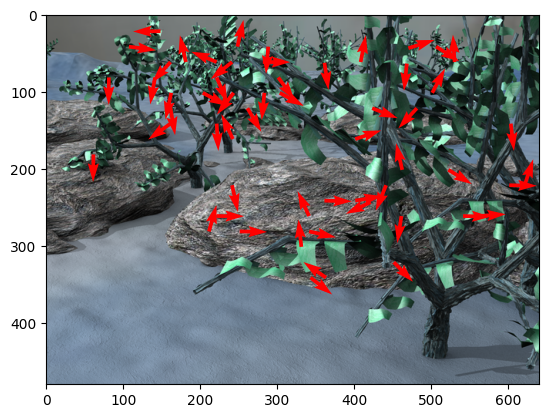

error

3.4067037706892545

**********Folder: Grove3 Frame: 10 - 11**************


Window Size: 5



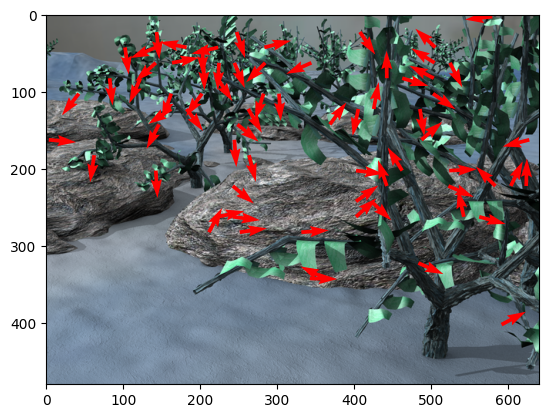

error

3.4061504885167384

**********Folder: Grove3 Frame: 10 - 11**************


Window Size: 8



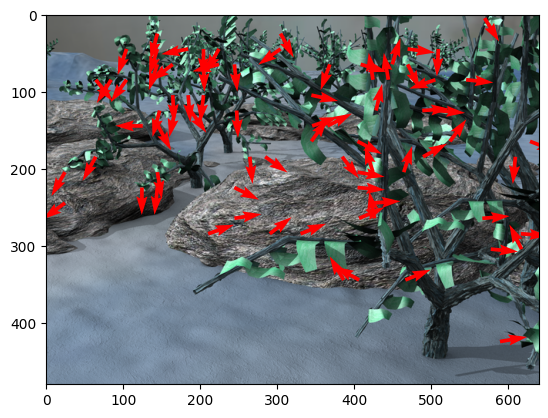

error

3.4067204745871766

**********Folder: Grove3 Frame: 10 - 11**************


Window Size: 11



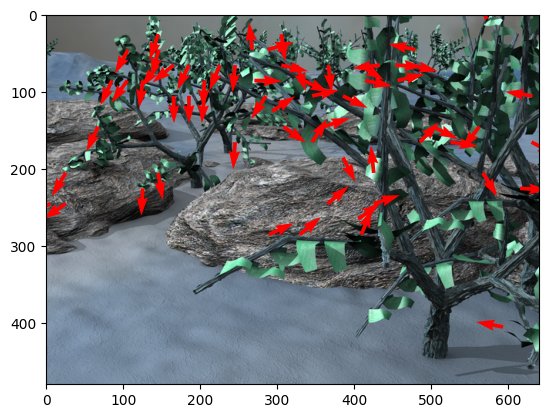

error

3.4070085744208014

**********Folder: Grove3 Frame: 10 - 11**************


Window Size: 14



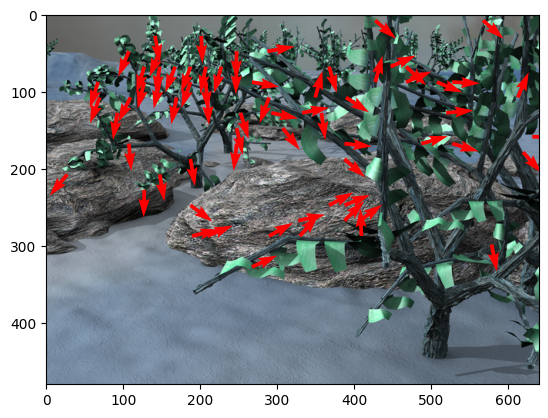

error

3.407206524292716

**********Folder: RubberWhale Frame: 10 - 11**************


Window Size: 2



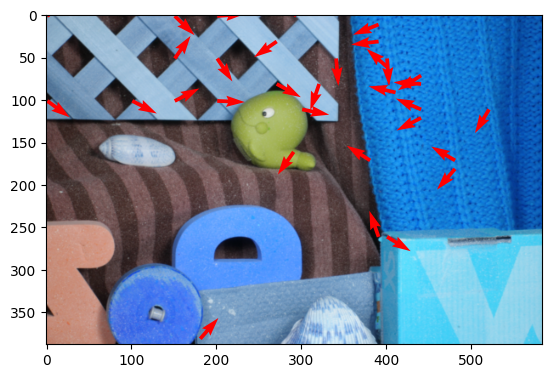

error

91357471.05508856

**********Folder: RubberWhale Frame: 10 - 11**************


Window Size: 5



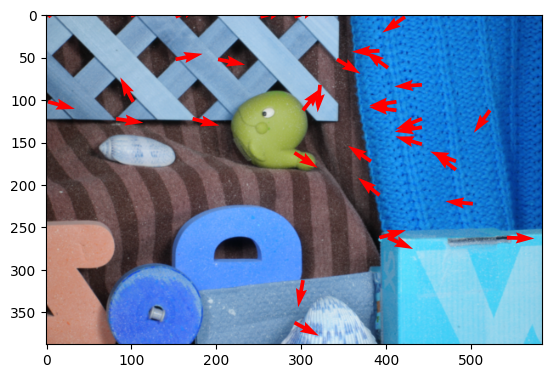

error

91357471.05550677

**********Folder: RubberWhale Frame: 10 - 11**************


Window Size: 8



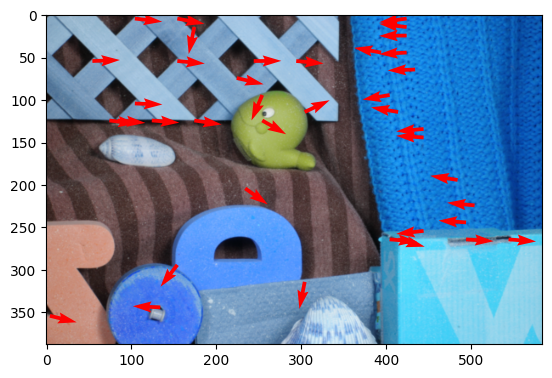

error

91357471.05524549

**********Folder: RubberWhale Frame: 10 - 11**************


Window Size: 11



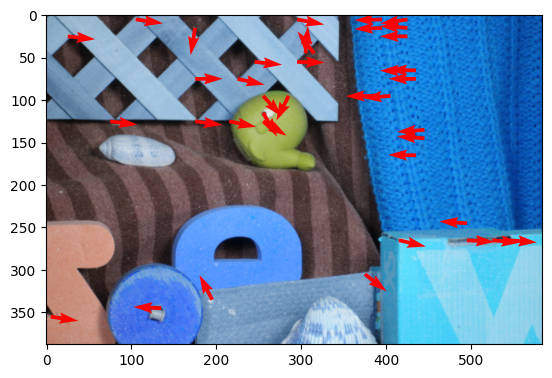

error

91357471.05507116

**********Folder: RubberWhale Frame: 10 - 11**************


Window Size: 14



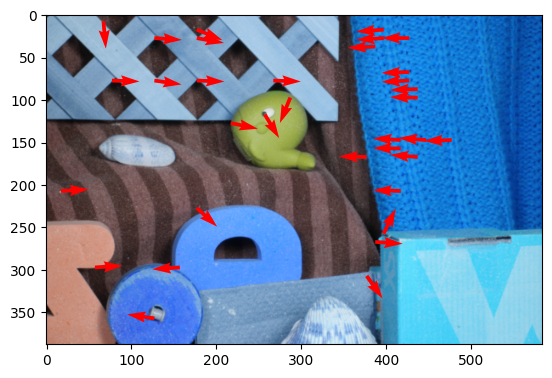

error

91357471.05513935

**********Folder: Urban2 Frame: 10 - 11**************


Window Size: 2



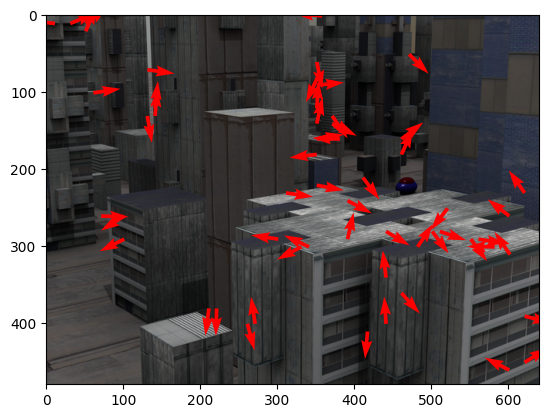

error

9.077714066345049

**********Folder: Urban2 Frame: 10 - 11**************


Window Size: 5



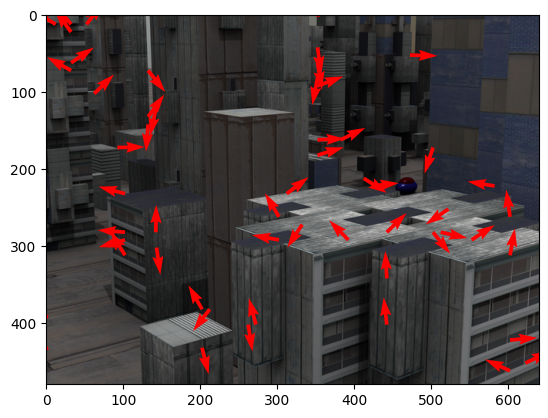

error

9.077950275261053

**********Folder: Urban2 Frame: 10 - 11**************


Window Size: 8



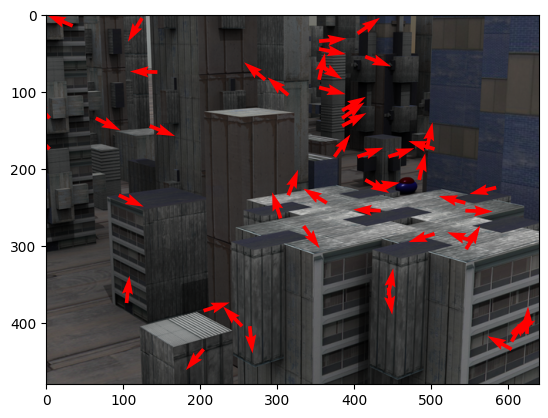

error

9.078924627447742

**********Folder: Urban2 Frame: 10 - 11**************


Window Size: 11



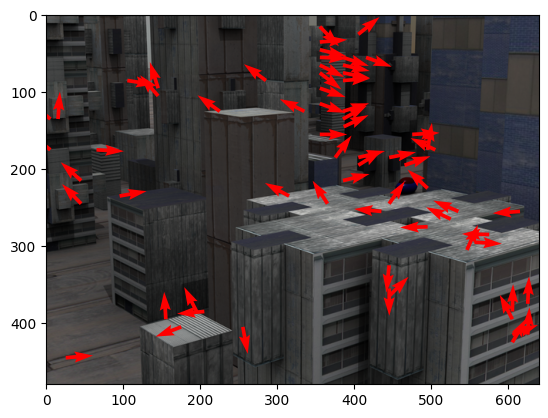

error

9.079171945366376

**********Folder: Urban2 Frame: 10 - 11**************


Window Size: 14



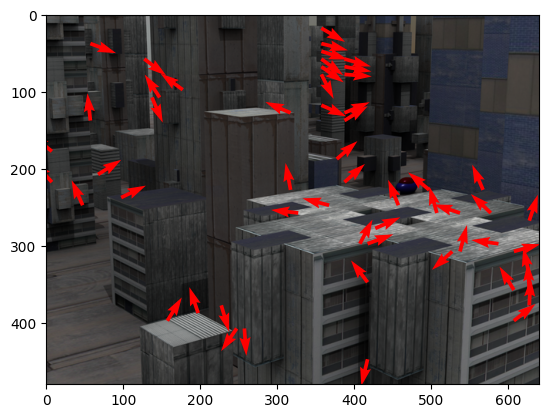

error

9.079247572435973


<Figure size 640x480 with 0 Axes>

In [28]:
change_window_size(15)

***3 Multi-Scale Coarse-to-fine Optical Flow***

Modify your algorithm to iteratively refine the optical flow estimate from multiple image resolutions.

Step 01. Gaussian smooth and scale Img1 and Img2 by a factor of 2ˆ(1-numLevels).


Step 02. Compute the optical flow at this resolution.


Step 03. For each level,


- Scale Img1 and Img2 by a factor of 2ˆ(1 - level)
- Upscale the previous layer‘s optical flow by a factor of 2
- Compute u and v by calling OpticalFlowRefine with the
    previous level‘s optical flow

In [17]:
def downSample(Img):
    down_img = cv.GaussianBlur(Img, (5,5), cv.BORDER_DEFAULT)
    return down_img[::2, ::2]

def upSample(Img):
    up_img = np.zeros( (2)*np.array(Img.shape),dtype=Img.dtype)
    up_img[::2,::2] = Img
    return up_img

In [18]:
def update_frame_corner(row_beg,row_end,col_beg,col_end,height_of_window,width_of_window,Img1):
    
    if row_beg < 0:
        row_beg = 0
        row_end = height_of_window - 1
    
    if row_end > (len(Img1[:, 0]) - 1):
        row_beg = len(Img1[:, 0]) - height_of_window
        row_end = len(Img1[:, 0]) - 1

    if col_beg < 0:
        col_beg = 0
        col_end = width_of_window - 1

    if col_end > (len(Img1[0, :]) - 1):
        col_beg = len(Img1[0, :]) - width_of_window
        col_end = len(Img1[0, :]) - 1
    
    return int(row_beg),int(row_end+1),int(col_beg),int(col_end+1)

In [19]:
def OpticalFlowRefine(Img1, Img2, windowSize, u0, v0):
    h1,w1 = Img1.shape
    height_of_window = windowSize[0]
    width_of_window = windowSize[1]
    int_u = np.round(u0)
    int_v = np.round(v0)
    window_half = windowSize[0] // 2

    u = np.zeros(Img1.shape)
    v = np.zeros(Img1.shape)

    for i in range(window_half, h1 - window_half):
        for j in range(window_half, w1 - window_half):
            firstImage_extract = Img1[i - window_half : i + window_half + 1, j - window_half : j + window_half + 1]

            #  indices to warp image2
            row_beg = (i - window_half) + int_v[i][j]
            col_beg = (j - window_half) + int_u[i][j]
            row_end = (i + window_half) + int_v[i][j]
            col_end = (j + window_half) + int_u[i][j]

            #  update indices if they are out of bounds
            row_beg,row_end,col_beg,col_end = update_frame_corner(row_beg,row_end,col_beg,col_end,height_of_window,width_of_window,Img1)
            secondImage_extract = Img2[row_beg :row_end, col_beg : col_end]

            u_lk, v_lk = LucasKanadeForwardAdditive(firstImage_extract, secondImage_extract, windowSize, 0.01)
            u[i][j] = u_lk[window_half, window_half] + int_u[i][j]
            v[i][j] = v_lk[window_half, window_half] + int_v[i][j]

    return u, v

In [20]:
def MultiScaleLucasKanade(Img1, Img2, windowSize, numLevels):
    
    I1 = np.array(Img1)
    I2 = np.array(Img2)
    hp1=I1.shape[0]
    wp1=I1.shape[1]
    hp2=I2.shape[0]
    wp2=I2.shape[1]
    N=windowSize[0]
    
    # Create pyramids by downsampling
    I1Pyr = np.empty((hp1, wp1, numLevels))
    I2Pyr = np.empty((hp2, wp2, numLevels))
    I1Pyr[:, :, 0] = I1
    I2Pyr[:, :, 0] = I2
    firstImage_original = Img1.copy()
    secondImage_original= Img2.copy()
    for level in range(1, numLevels):
        I1 = downSample(I1)
        hh1=I1.shape[0]
        ww1= I1.shape[1]
        I1Pyr[0 : hh1, 0 :ww1, level] = I1
        I2 = downSample(I2)
        hh2=I2.shape[0]
        ww2=I2.shape[1]
        I2Pyr[0 :hh2 , 0 : ww2, level] = I2

    # Find optical flow at level0 and refine it with iterative Lucas Kande method
    level0 = numLevels - 1
    level0_scale = 2 ** level0
    scale_x01=(len(I1Pyr[:, 0]) // level0_scale)
    scale_y01=(len(I1Pyr[0, :]) // level0_scale)
    firstImage_level0 = I1Pyr[0 :scale_x01 , 0 : scale_y01, level0]
    scale_x02=(len(I2Pyr[:, 0]) // level0_scale)
    scale_y02=(len(I2Pyr[0, :]) // level0_scale)
    secondImage_level0 = I2Pyr[0 : scale_x02,0 :scale_y02,level0]
    
    (u, v) = LucasKanadeForwardAdditive(firstImage_original, secondImage_original, np.array([N, N]))

    for i in range(0, 5):
        (u, v) = OpticalFlowRefine(firstImage_level0, secondImage_level0, np.array([N, N]),u, v )
    
    u_levels = []
    u_levels.append(u.copy())
    v_levels = []
    v_levels.append(v.copy())

    # Find optical flow at all levels of pyramid
    for k in range(1, numLevels):
        kth_level = numLevels - (k + 1)
        upsampled_u = upSample(u)
        upsampled_v = upSample(v)
        scale_kth_level = 2 ** kth_level
        scale_x1=(len(I1Pyr[:, 0]) // scale_kth_level)
        scale_y1=(len(I1Pyr[0, :]) // scale_kth_level)
        firstImageIntermediate = I1Pyr[0 : scale_x1,0 : scale_y1,kth_level]
        scale_x2=(len(I2Pyr[:, 0]) // scale_kth_level)
        scale_y2=(len(I2Pyr[0, :]) // scale_kth_level)
        secondImageIntermediate = I2Pyr[0 : scale_x2,0 : scale_y2,kth_level]
       
        (u, v) = OpticalFlowRefine(firstImageIntermediate, secondImageIntermediate,np.array([N, N]), upsampled_u, upsampled_v)

        u_levels.append(u.copy())
        v_levels.append(v.copy())

    return u_levels[-1],v_levels[-1]

In [21]:
def invoke():    
    folders = ["Grove3","RubberWhale","Urban2"]
    dist_thresholds = [20,10,10]
    q_thresholds = [0.005,0.0005,0.0005]
    itr = 0
    for i in folders:
        # if itr != 1:
        #     itr = itr + 1
        #     continue
        for j in range(7,14):
            nxt=j+1
            print("\n**********Folder: "+folders[itr]+" Frame: "+str(j)+" - "+str(nxt)+"**************\n")
            
            if j < 10:
                Img1="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(j)+".png"
                if(nxt<10):
                    Img2="../data/all-frames-colour/"+folders[itr]+"/frame0"+str(nxt)+".png"
                else:
                    Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
            else:
                Img1="../data/all-frames-colour/"+folders[itr]+"/frame"+str(j)+".png"
                Img2="../data/all-frames-colour/"+folders[itr]+"/frame"+str(nxt)+".png"
            img1=cv.imread(Img1)
            img2=cv.imread(Img2)
            img1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
            img2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)
            print("\nMultiScaleLucasKanade\n")
            u_new1,v_new1=MultiScaleLucasKanade(img1,img2, np.array([15,15]), 4)
            quiver_plot(Img1,u_new1,v_new1,q_thresholds[itr],corn_points[itr],dist_thresholds[itr])
            if j==10:
                print("error\n")
                print(avg_epe(u_new1,v_new1,"../data/ground-truth-flow/"+folders[itr]+"/flow10.flo",corn_points[itr]))
        itr = itr + 1


**********Folder: Grove3 Frame: 7 - 8**************


MultiScaleLucasKanade



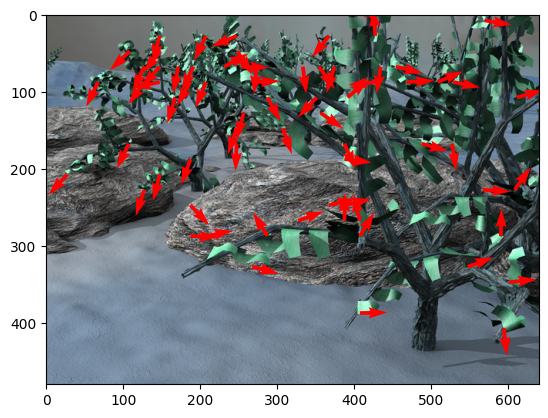


**********Folder: Grove3 Frame: 8 - 9**************


MultiScaleLucasKanade



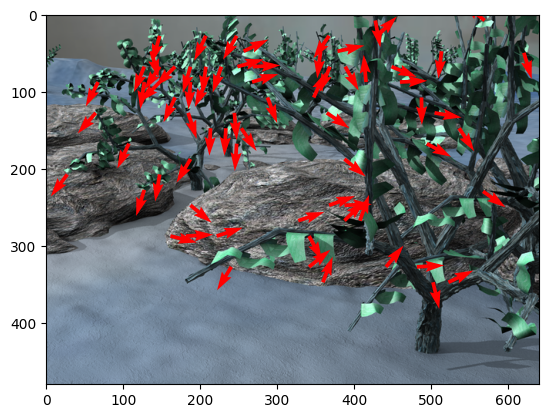


**********Folder: Grove3 Frame: 9 - 10**************


MultiScaleLucasKanade



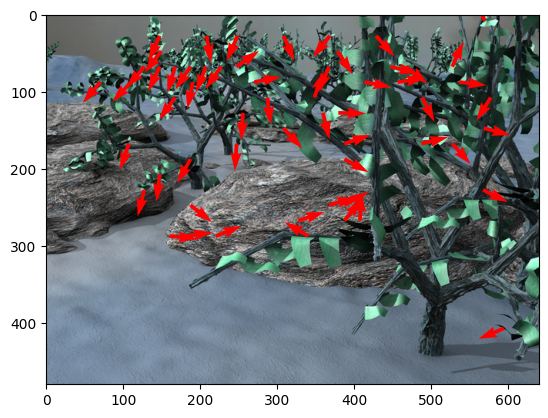


**********Folder: Grove3 Frame: 10 - 11**************


MultiScaleLucasKanade



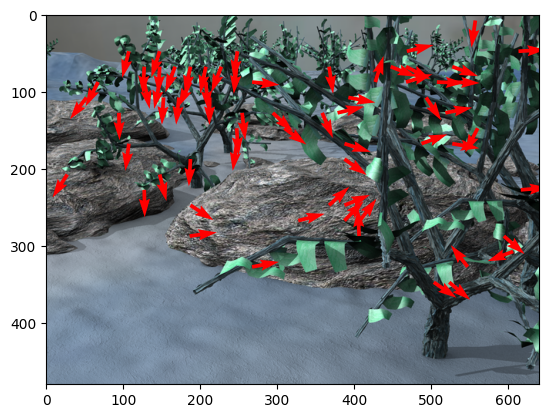

error

3.4074713052613816

**********Folder: Grove3 Frame: 11 - 12**************


MultiScaleLucasKanade



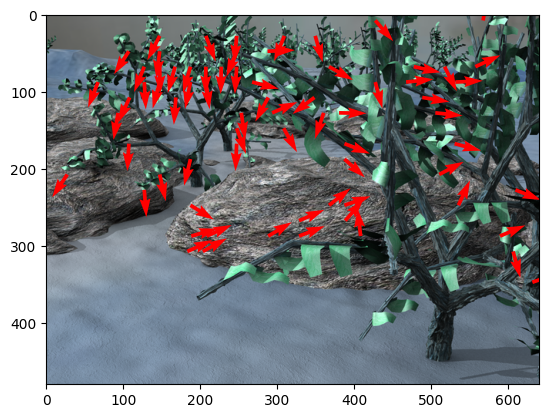


**********Folder: Grove3 Frame: 12 - 13**************


MultiScaleLucasKanade



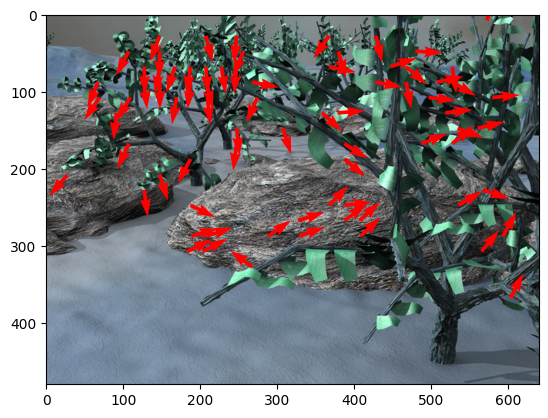


**********Folder: Grove3 Frame: 13 - 14**************


MultiScaleLucasKanade



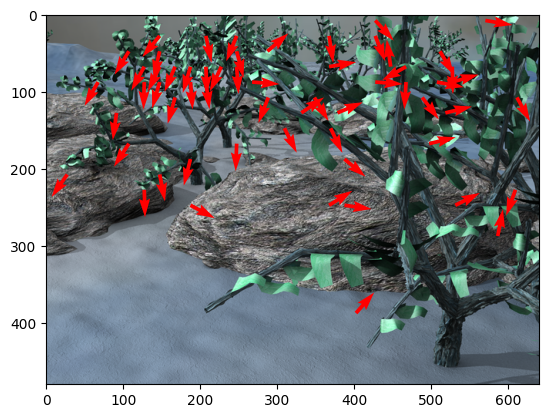


**********Folder: RubberWhale Frame: 7 - 8**************


MultiScaleLucasKanade



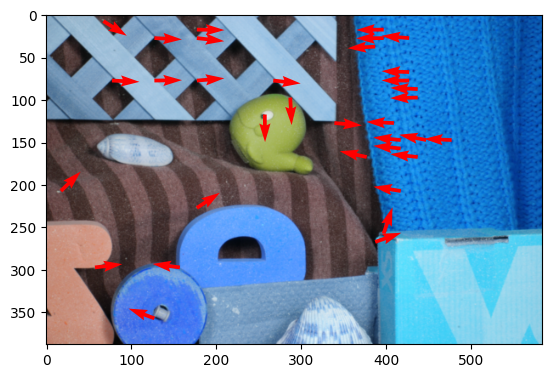


**********Folder: RubberWhale Frame: 8 - 9**************


MultiScaleLucasKanade



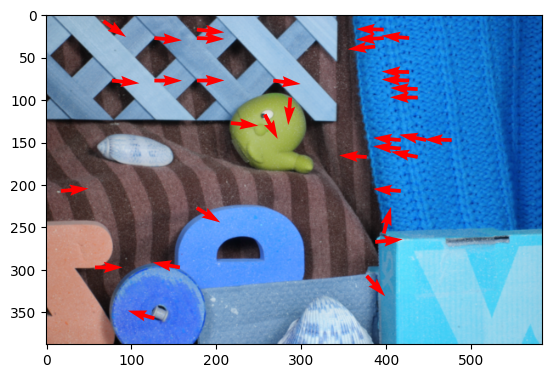


**********Folder: RubberWhale Frame: 9 - 10**************


MultiScaleLucasKanade



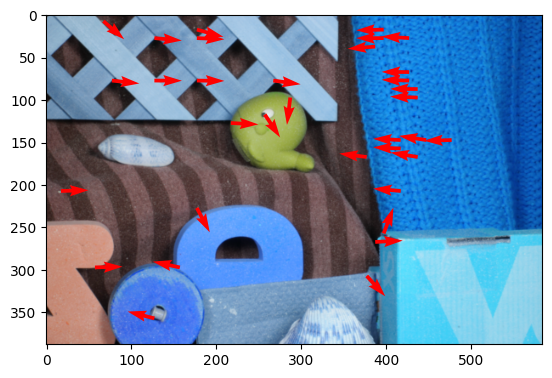


**********Folder: RubberWhale Frame: 10 - 11**************


MultiScaleLucasKanade



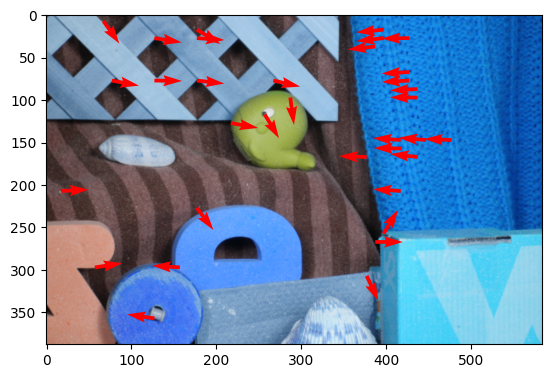

error

91357471.05504923

**********Folder: RubberWhale Frame: 11 - 12**************


MultiScaleLucasKanade



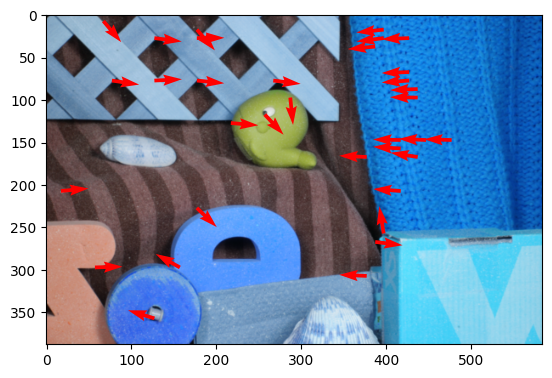


**********Folder: RubberWhale Frame: 12 - 13**************


MultiScaleLucasKanade



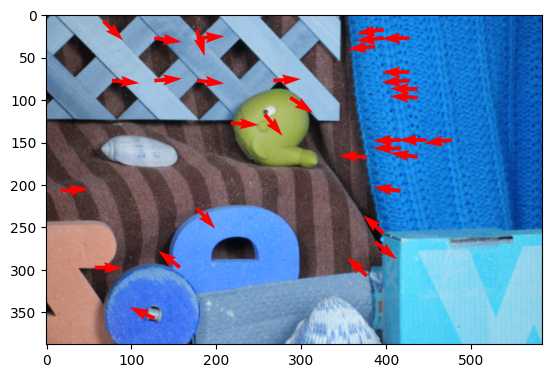


**********Folder: RubberWhale Frame: 13 - 14**************


MultiScaleLucasKanade



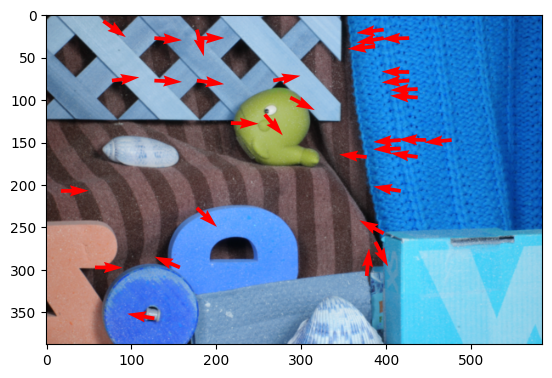


**********Folder: Urban2 Frame: 7 - 8**************


MultiScaleLucasKanade



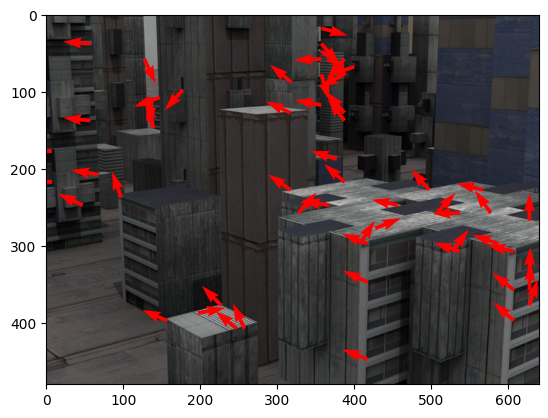


**********Folder: Urban2 Frame: 8 - 9**************


MultiScaleLucasKanade



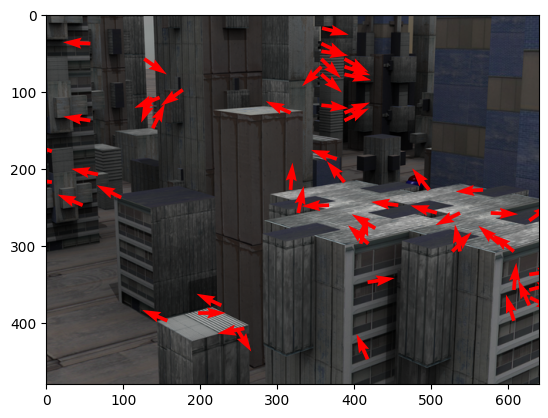


**********Folder: Urban2 Frame: 9 - 10**************


MultiScaleLucasKanade



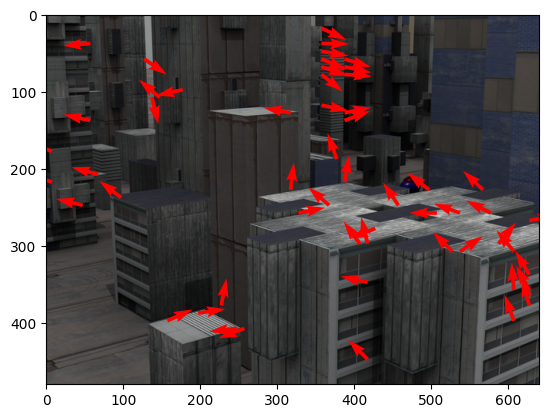


**********Folder: Urban2 Frame: 10 - 11**************


MultiScaleLucasKanade



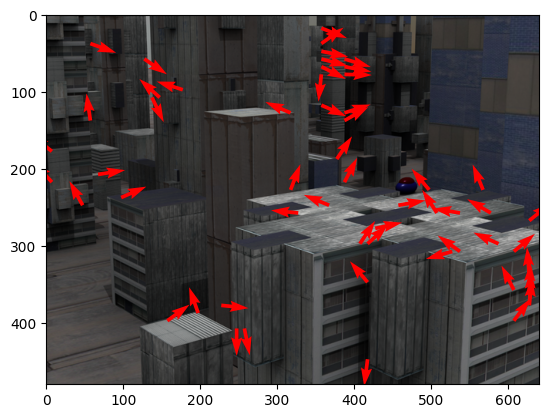

error

9.07940591779002

**********Folder: Urban2 Frame: 11 - 12**************


MultiScaleLucasKanade



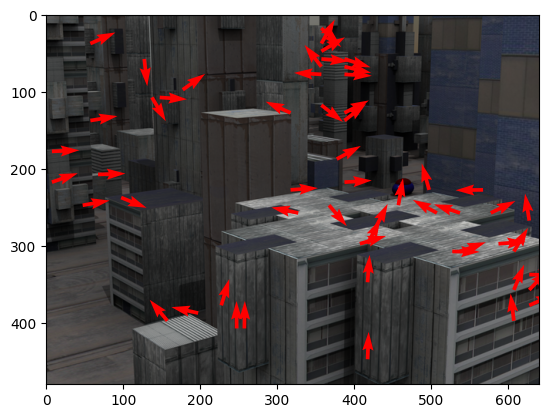


**********Folder: Urban2 Frame: 12 - 13**************


MultiScaleLucasKanade



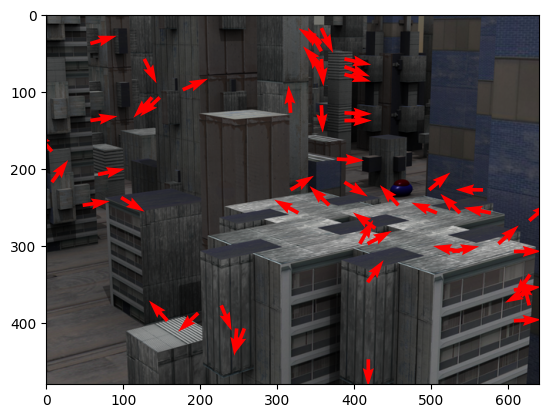


**********Folder: Urban2 Frame: 13 - 14**************


MultiScaleLucasKanade



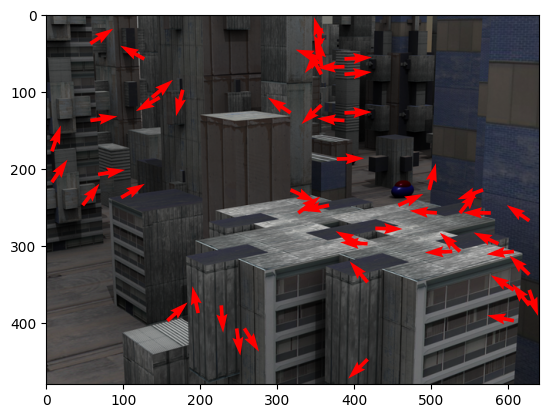

<Figure size 640x480 with 0 Axes>

In [22]:
invoke()

In [41]:
def I2V(fps,total_frames):
    folders=["Grove3","RubberWhale","Urban2"]
    for itr in range(0,3):
        frame_list=[]
        j=7
        i=0
        while i<total_frames:
            nxt=j+1
            frm="../results/LKmultiScale/"+folders[itr]+"/frame"+str(j)+"-"+str(nxt)+".png"
            imgs=cv.imread(frm)
            frame_list.append(imgs)
            i=i+1
            j=j+1
        height,width,layer = frame_list[0].shape
        size = (width,height)
        fourcc = cv.VideoWriter_fourcc('m', 'p', '4', 'v')
        file_path = "../results/LKmultiScale/"+folders[itr]+"/video/"+"vid.mp4"
        video = cv.VideoWriter(file_path,fourcc,fps,size)
        i = 0
        while i<total_frames:
            video.write(frame_list[i])
            i=i+1
        video.release()
        cv.destroyAllWindows()

In [42]:
I2V(2,7)

**Subplot**

In [50]:
def plot_three_images(imgs):
    fig, ax = plt.subplots(1, 3, figsize=(15, 15))
    ax[0].imshow(cv.cvtColor(imgs[0], cv.COLOR_BGR2RGB))
    ax[0].set_title('My_Implementation')
    ax[1].imshow(cv.cvtColor(imgs[1], cv.COLOR_BGR2RGB))
    ax[1].set_title('OpenCV')
    ax[2].imshow(cv.cvtColor(imgs[2], cv.COLOR_BGR2RGB))
    ax[2].set_title('LKmultiScale')
    plt.show()

In [51]:
def pick_3_images():
    parent_folders=["My_Implementation","OpenCV","LKmultiScale"]
    folders = ["Grove3","RubberWhale","Urban2"]
    for itr in range(0,3):
        for j in range(7,14):
            nxt=j+1
            im1="../results/"+parent_folders[0]+"/"+folders[itr]+"/frame"+str(j)+"-"+str(nxt)+".png"
            im2="../results/"+parent_folders[1]+"/"+folders[itr]+"/frame"+str(j)+"-"+str(nxt)+".png"
            im3="../results/"+parent_folders[2]+"/"+folders[itr]+"/frame"+str(j)+"-"+str(nxt)+".png"
            imgs = [cv.imread(im1),cv.imread(im2),cv.imread(im3)]
            plot_three_images(imgs)

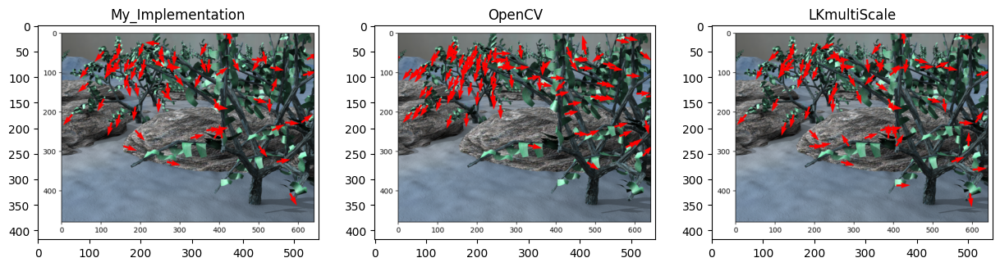

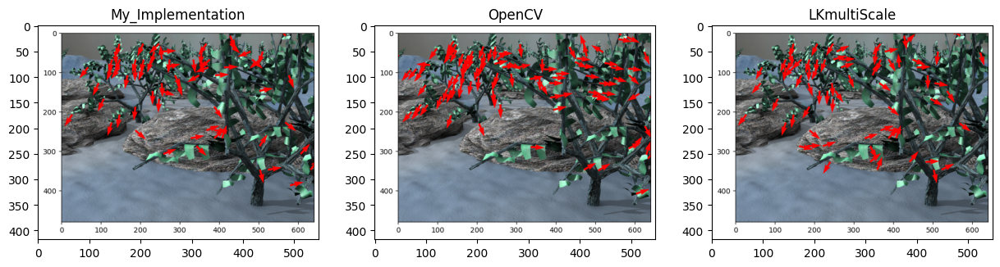

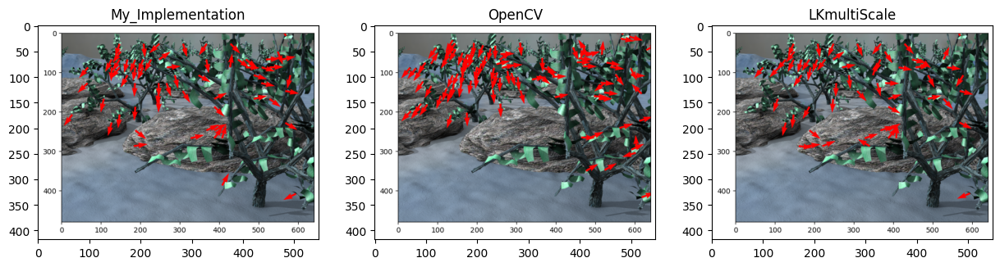

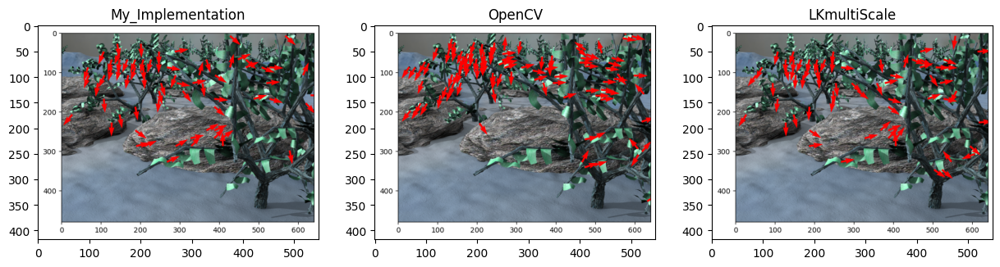

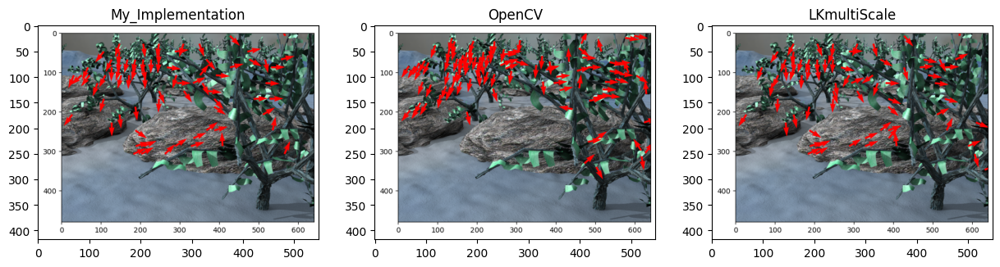

...

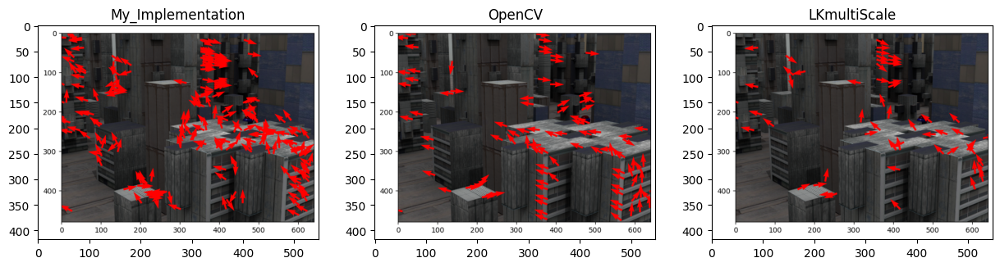

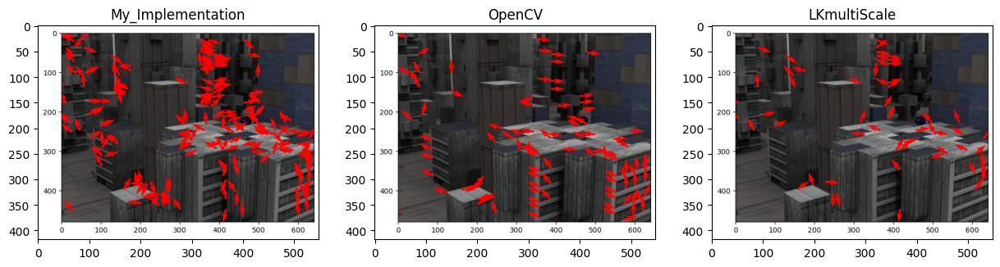

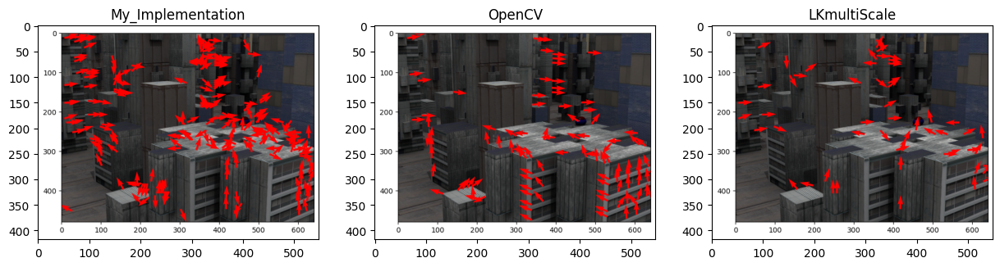

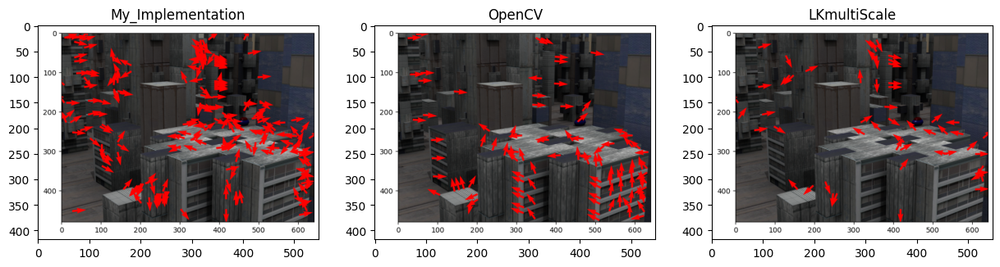

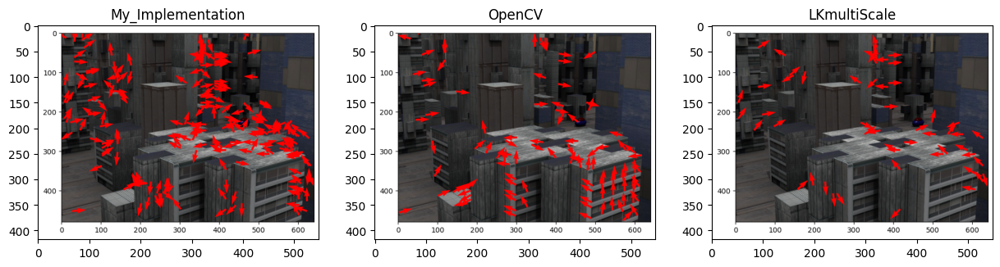

In [52]:
pick_3_images()